# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDiscreteRepresentation
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 6

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
summary_models = SummaryModels(file_name)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size, zoom=zoom)
visualise_trajectories_discrete = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size,
                                                        zoom=zoom, continuous_representation=False)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    visualise_trajectories_discrete.fig_size = (20,10)
    fig, ax = visualise_trajectories_discrete.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories_discrete.plot_figures
    visualise_trajectories_discrete.plot_figures = False
        
    # Plot a single complete vessel trajectory on the static map - Discrete representation
    index = df_n.iloc[idx]["Index"]
    data_set = AISDiscreteRepresentation(file_name, data_info=data_info, indicies=[index])
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=False)
    visualise_trajectories_discrete.plot_single_track(df_actual, ax[0], use_cmap=True)

    # Plot the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    df_recon = reconstruction["Reconstruction"][1:]
    visualise_trajectories_discrete.plot_figures = plot_figures_tmp
    visualise_trajectories_discrete.plot_single_track(df_recon, ax[1], use_cmap=True)
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

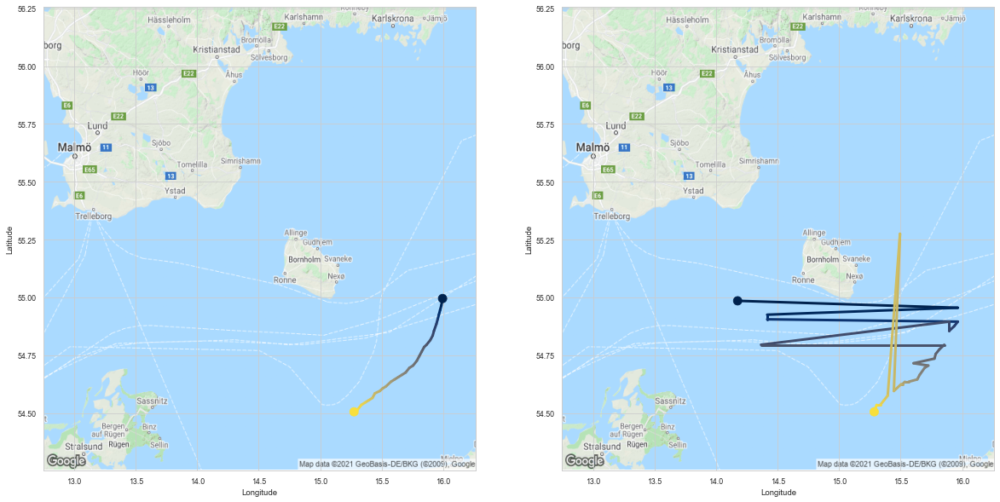

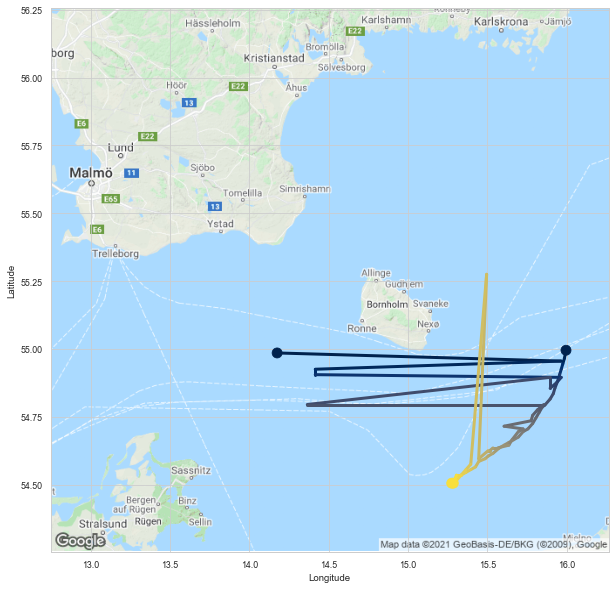

In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(98)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories_discrete.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories_discrete.plot_figures = False
visualise_trajectories_discrete.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories_discrete.plot_figures = plot_figures_tmp
visualise_trajectories_discrete.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

# Best Fishing Reconstructions

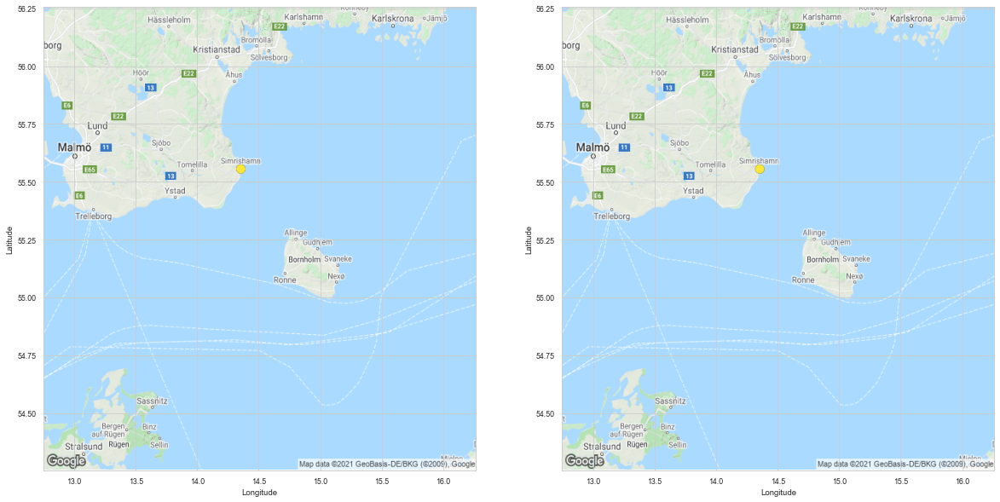

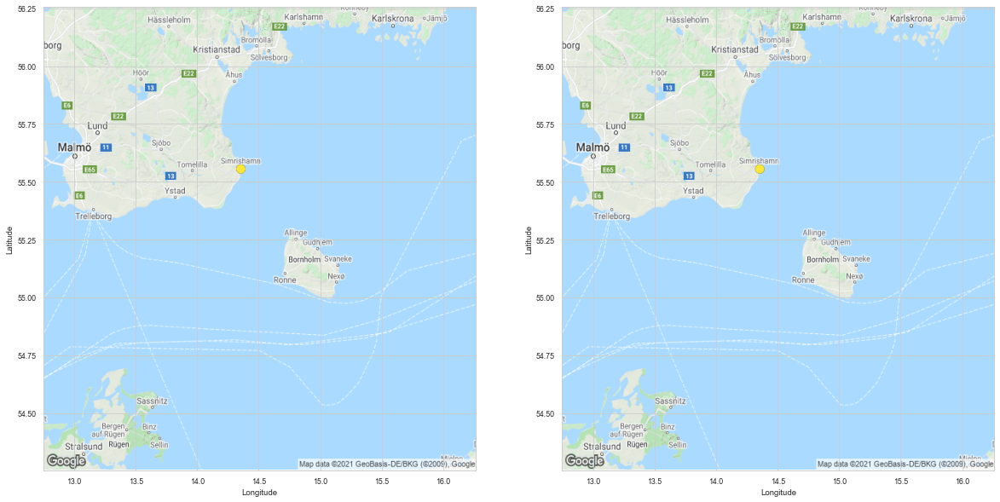

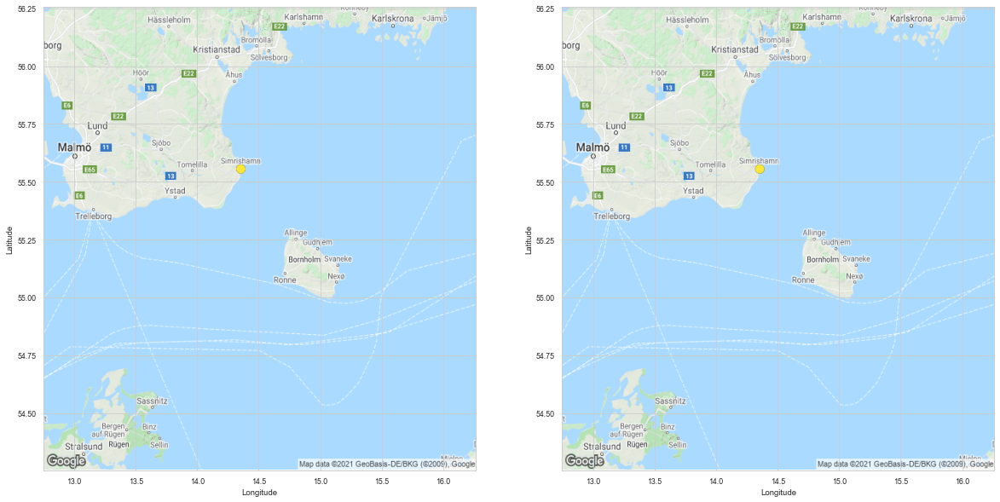

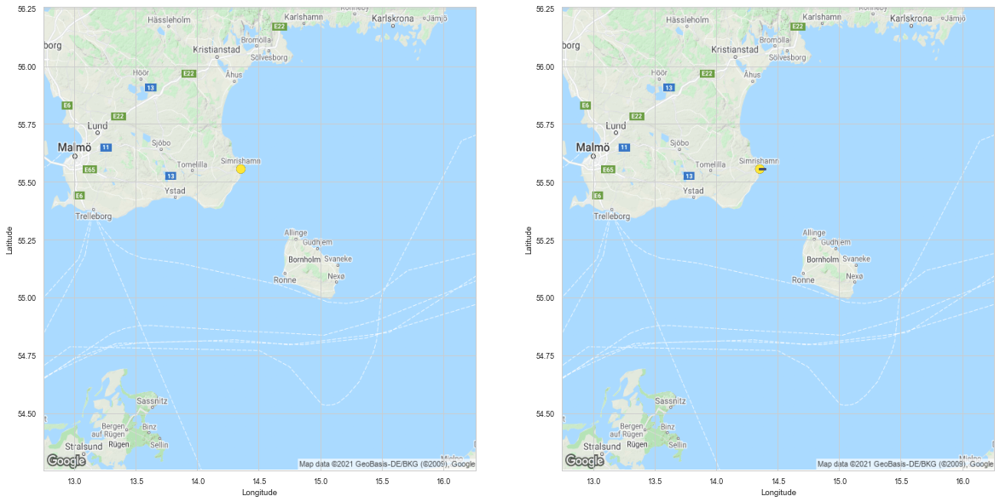

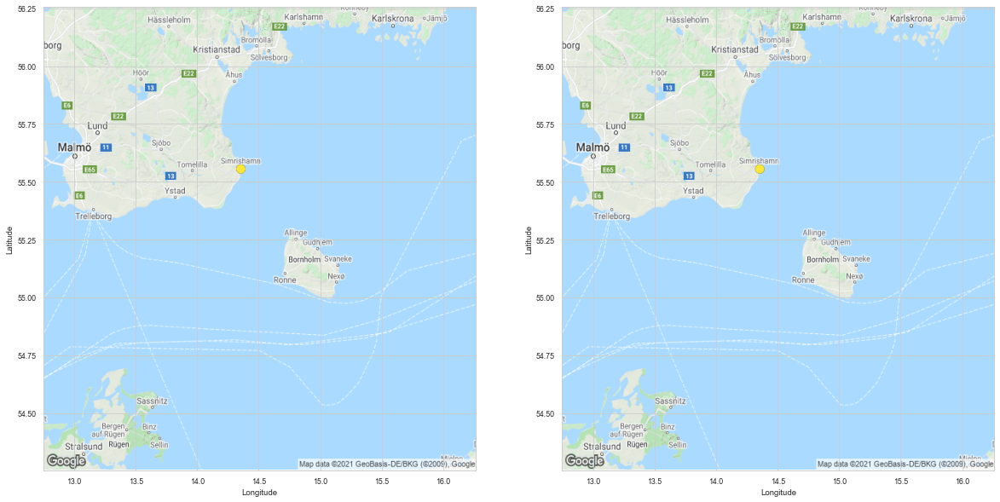

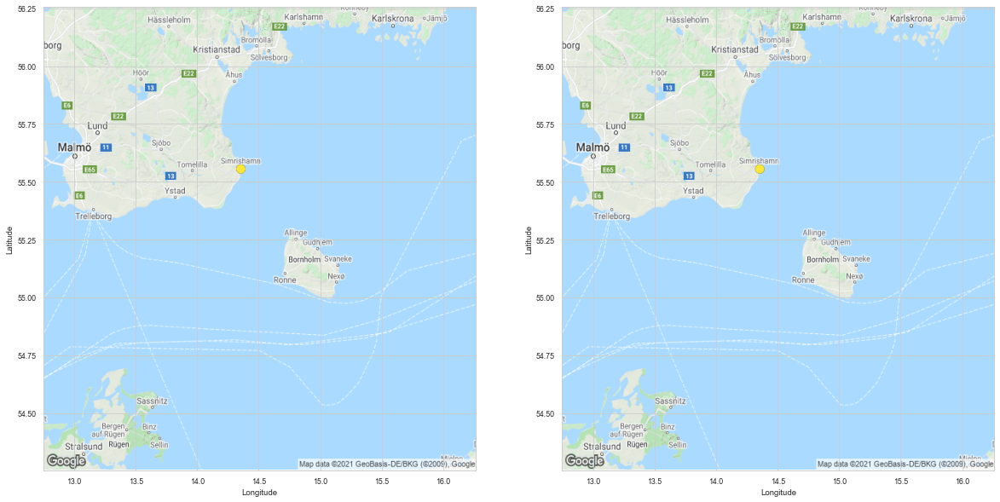

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,1583421,219021428,Fishing,135,-6.242452,-0.046240
43,43,5760657,265750000,Fishing,139,-12.340321,-0.088779
52,52,5635000,265750000,Fishing,140,-13.543082,-0.096736
85,85,6525750,265755000,Fishing,141,-101.935204,-0.722945
76,76,5480216,265750000,Fishing,142,-134.922958,-0.950162
42,42,5972813,265754000,Fishing,143,-175.926605,-1.230256


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

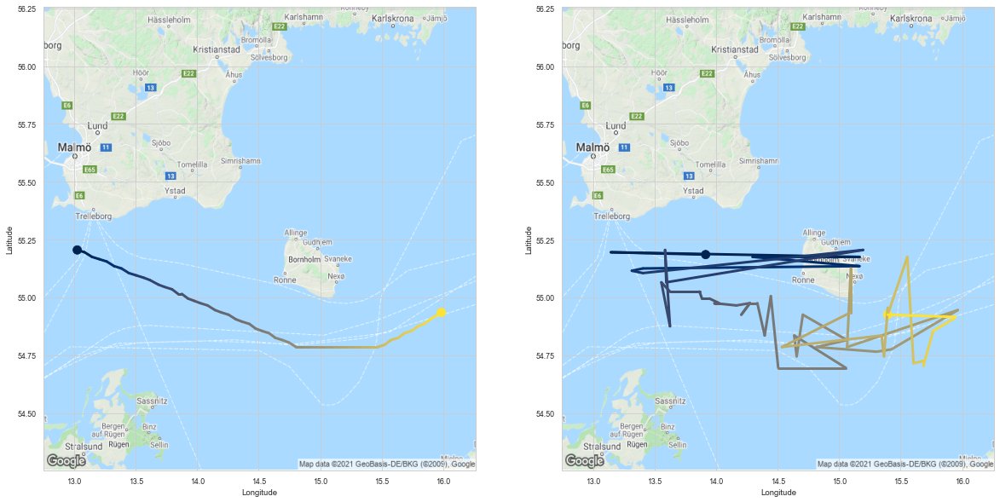

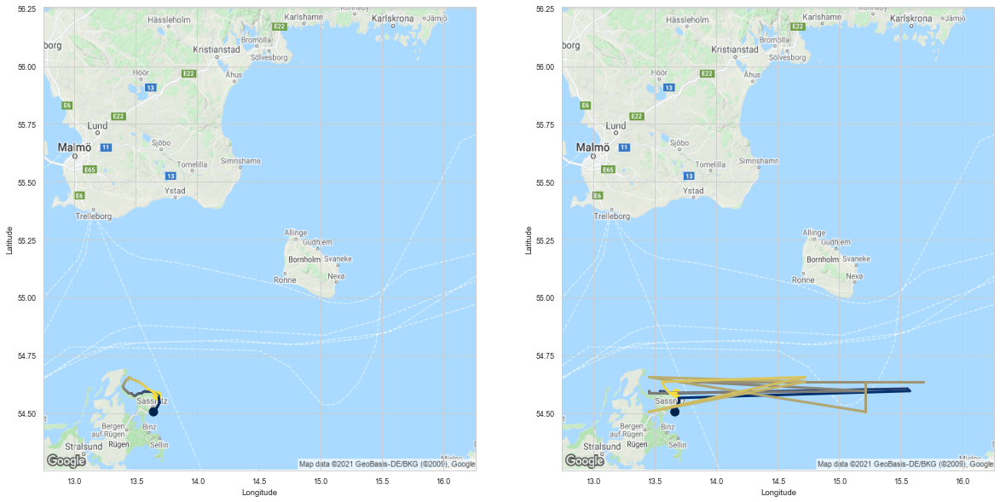

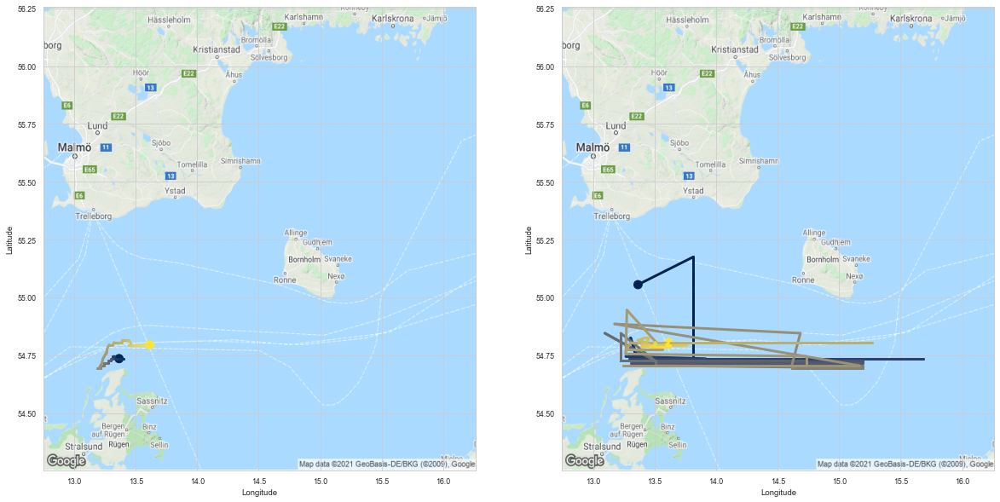

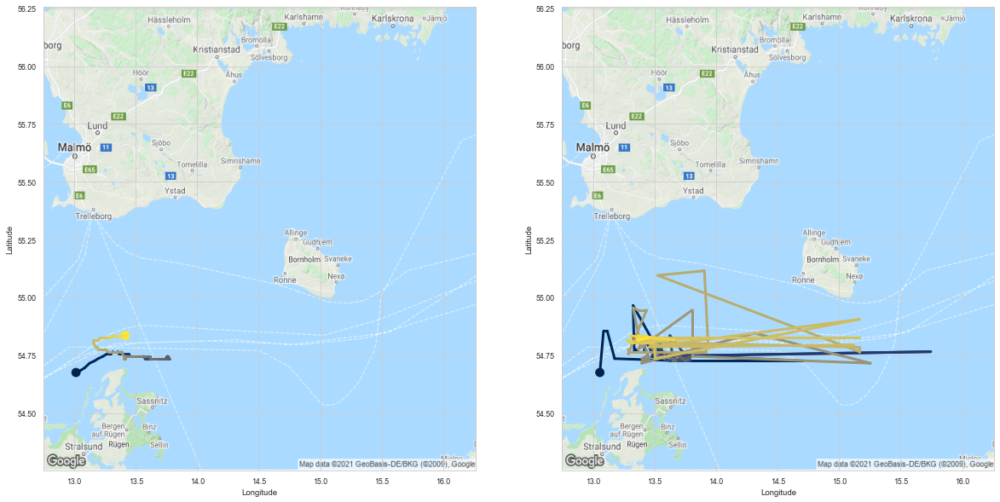

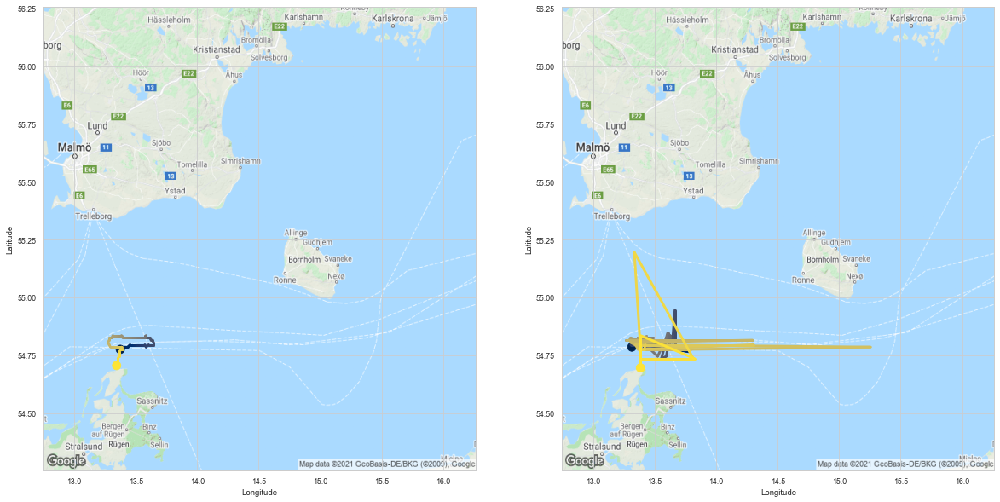

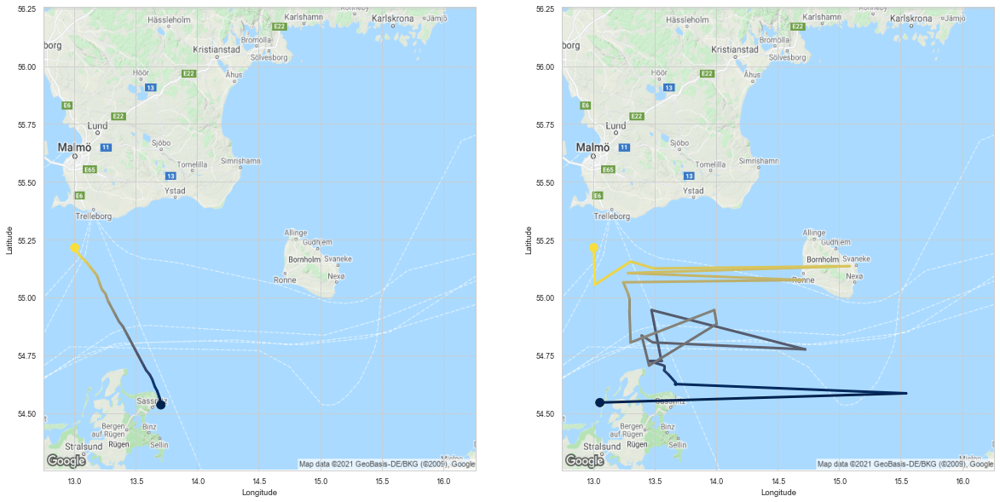

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-2687.123291,-49.761542
73,73,1113112,211542610,Fishing,30,-1086.681641,-36.222721
21,21,19488,211243240,Fishing,110,-3971.604248,-36.105493
2,2,295372,211314800,Fishing,124,-3894.565918,-31.407790
90,90,32291,211243240,Fishing,86,-2331.712891,-27.112941
101,101,1176042,211755650,Fishing,30,-751.848816,-25.061627


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Best 100 Reconstructions

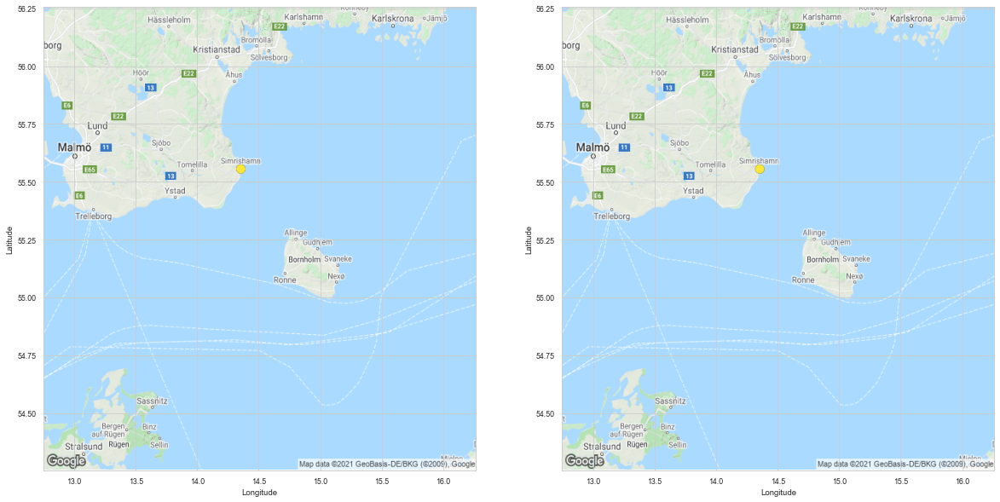

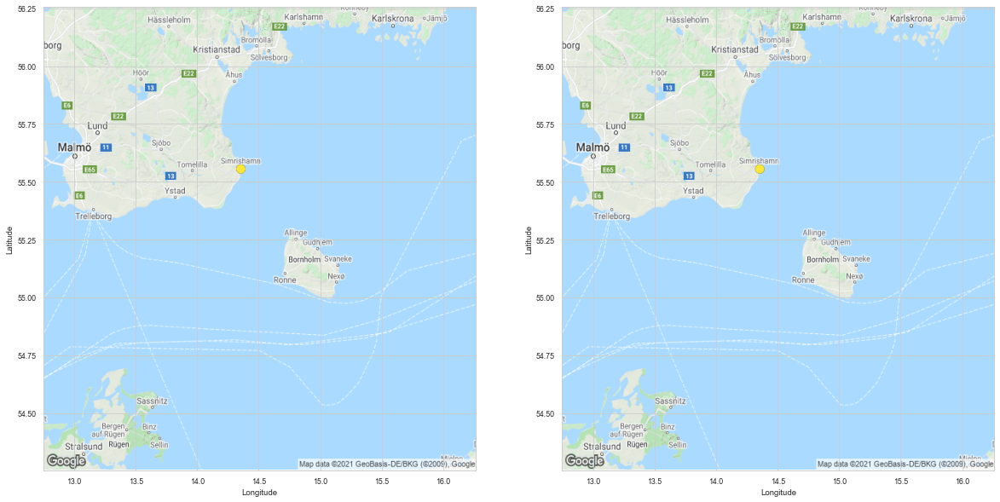

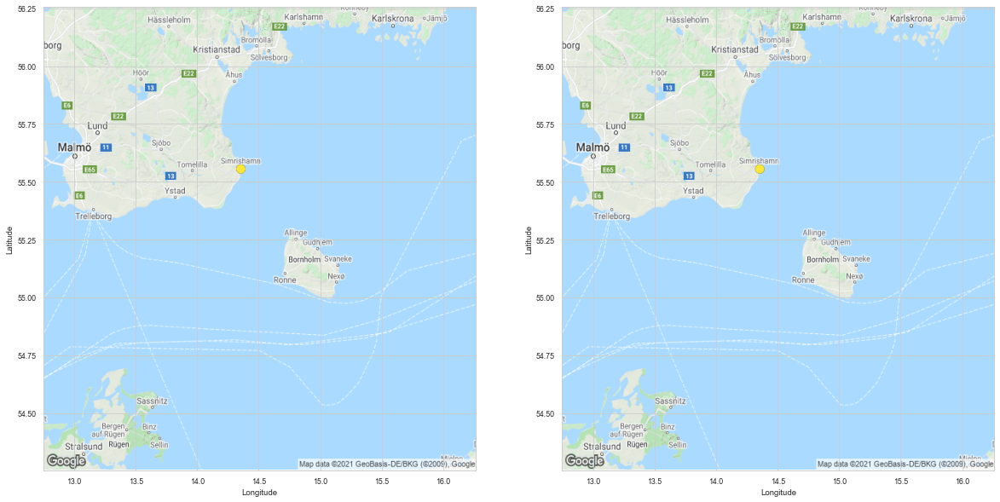

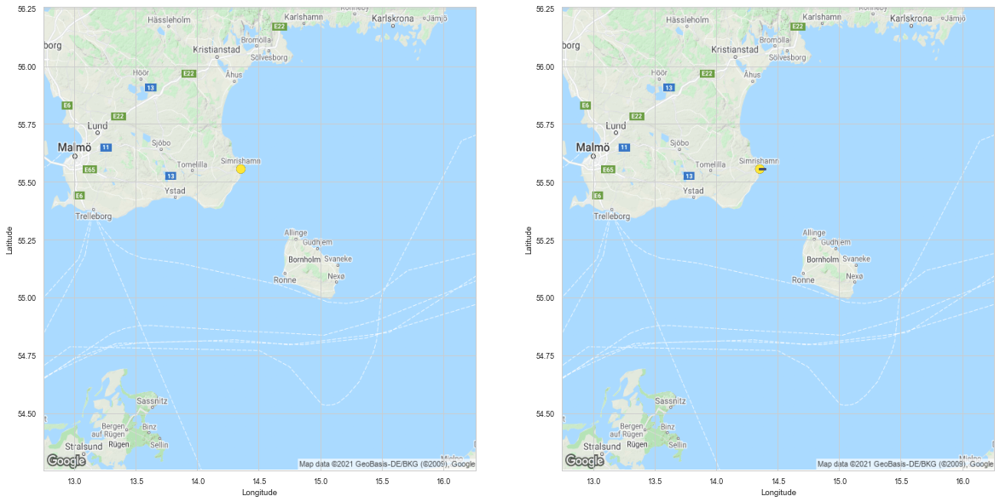

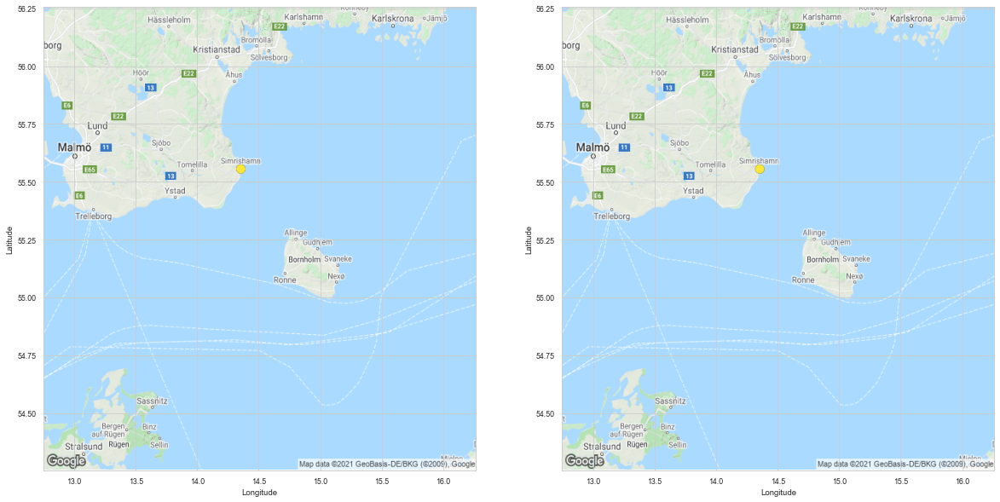

...

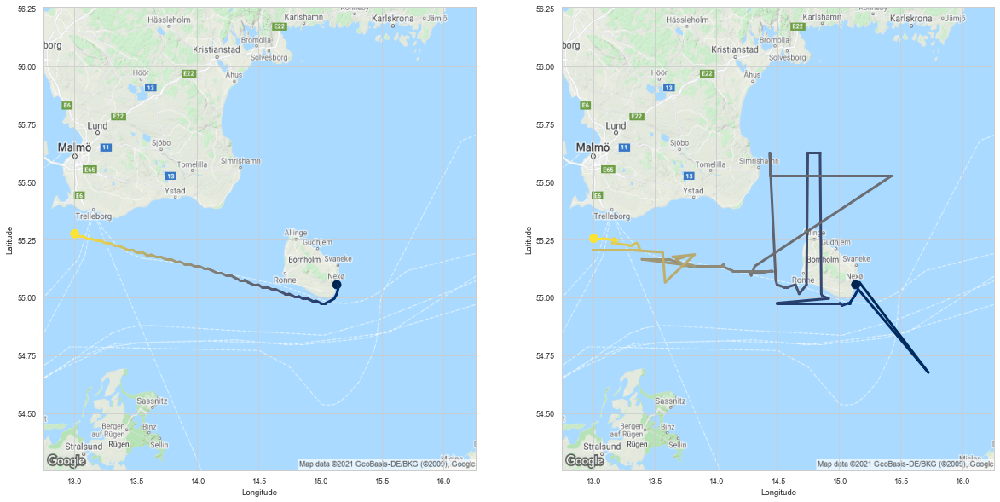

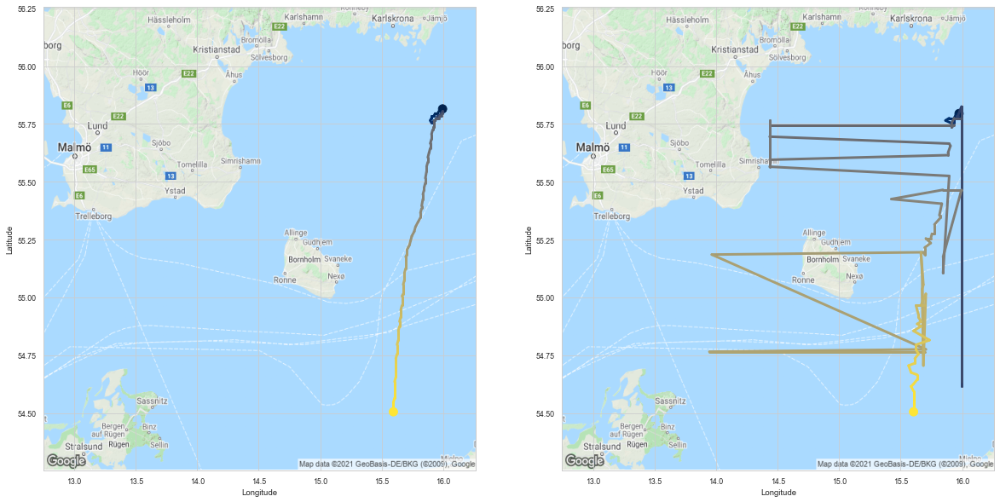

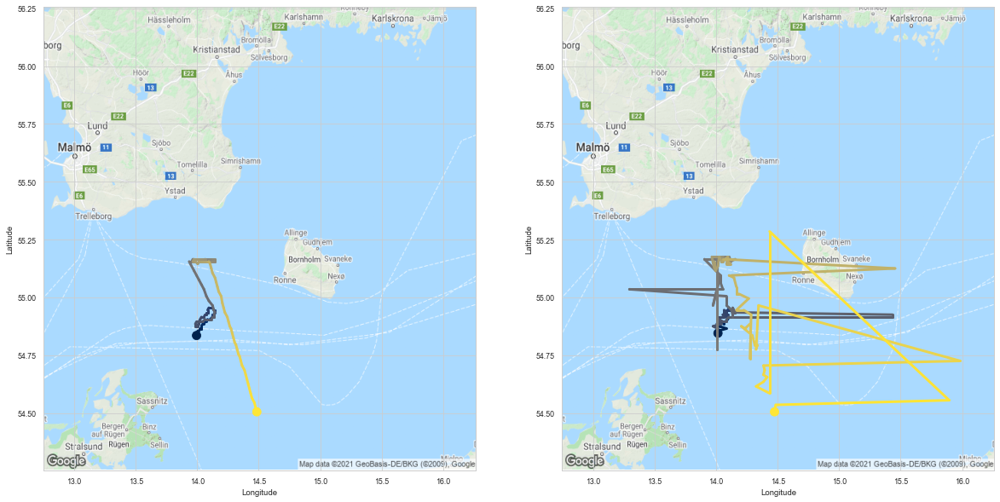

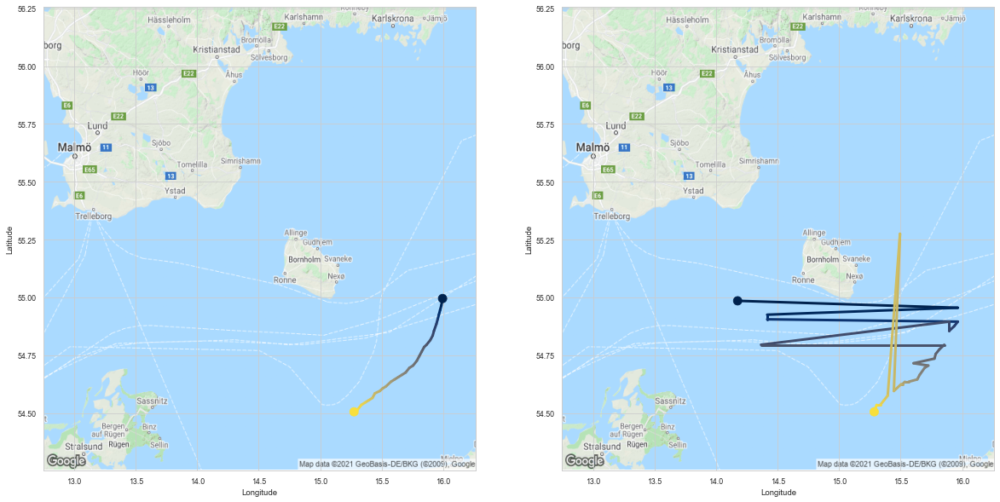

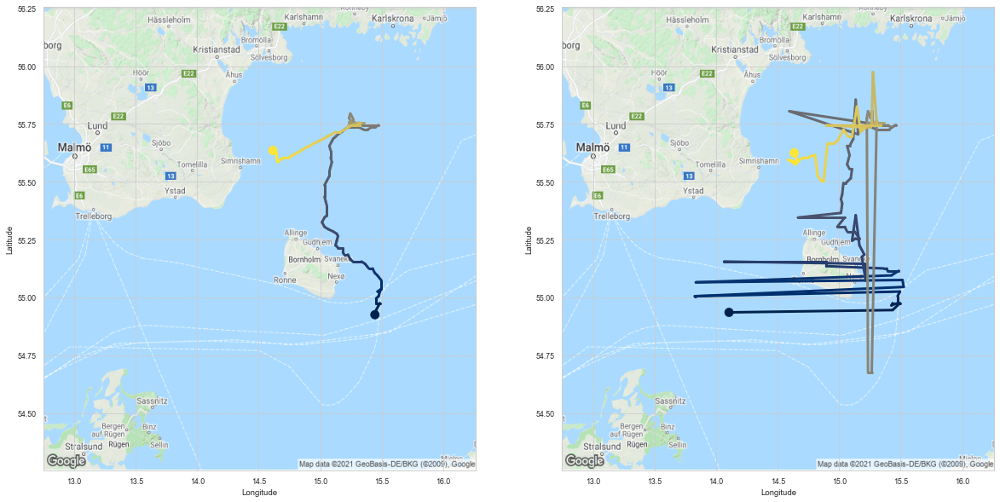

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,1583421,219021428,Fishing,135,-6.023529,-0.044619
43,43,5760657,265750000,Fishing,139,-11.717472,-0.084298
52,52,5635000,265750000,Fishing,140,-14.345098,-0.102465
85,85,6525750,265755000,Fishing,141,-94.093094,-0.667327
76,76,5480216,265750000,Fishing,142,-141.574142,-0.997001
...,...,...,...,...,...,...,...
37,37,1615516,220339000,Fishing,64,-1150.316895,-17.973701
33,33,4352040,261015270,Fishing,113,-2094.478271,-18.535206
14,14,3052441,261002520,Fishing,143,-2683.304932,-18.764370
1,1,4547326,261061000,Fishing,31,-601.226624,-19.394407


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
df_n